In [11]:

import warnings

# Ignore all warnings
warnings.filterwarnings("ignore")

import sys
sys.path.append('../')
import cv2
import numpy as np
import os

import torch
import torch.nn.functional as F
from torchvision import transforms
import matplotlib.pyplot as plt

from utils.visualize_data import visualize_batch, display_CV2_image
from utils.attention import visualize_attn
import torchvision.utils as utils
from data_prep.dataset import Dataset
from data_prep.dataset_loader import LoadData
from networks.VGG16 import VGG16_BN_Attention

# To allow auto reload to this notebook after modifying any external file imported
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


### 1. Experimenting with masks

In [2]:
dataset_path_train = '../datasets/challenge1/train'
dataset_path_masks = '../datasets_masks/challenge1/train'

ch1_labels = {'nevus': 0, 'others': 1}
ch2_labels = {'mel': 0, 'bcc': 1, 'scc': 2}

_, images, masks, labels, n_classes = \
    LoadData(dataset_path_train,
             dataset_path_masks,
             class_labels = ch1_labels)

Loading the data from ../datasets/challenge1/train


In [3]:
print(len(images), len(masks))

15195 15195


In [4]:
dataset = Dataset(
    images_path=images,
    labels=labels,
    masks_path=masks,
    transform=True,
    split="train",
    input_size=(224,224)
    )

In [5]:
print(dataset.images_path[:5])
print(dataset.masks_path[:5])
print(dataset.labels[:5])

['/mnt/c/Users/abdal/Documents/Master/EMJMD MAIA/SEMESTER 3 - UdG/CAD/skin-lesion-dl-classifier/notebooks/../datasets/challenge1/train/nevus/nev00001.jpg', '/mnt/c/Users/abdal/Documents/Master/EMJMD MAIA/SEMESTER 3 - UdG/CAD/skin-lesion-dl-classifier/notebooks/../datasets/challenge1/train/nevus/nev00002.jpg', '/mnt/c/Users/abdal/Documents/Master/EMJMD MAIA/SEMESTER 3 - UdG/CAD/skin-lesion-dl-classifier/notebooks/../datasets/challenge1/train/nevus/nev00003.jpg', '/mnt/c/Users/abdal/Documents/Master/EMJMD MAIA/SEMESTER 3 - UdG/CAD/skin-lesion-dl-classifier/notebooks/../datasets/challenge1/train/nevus/nev00004.jpg', '/mnt/c/Users/abdal/Documents/Master/EMJMD MAIA/SEMESTER 3 - UdG/CAD/skin-lesion-dl-classifier/notebooks/../datasets/challenge1/train/nevus/nev00005.jpg']
['/mnt/c/Users/abdal/Documents/Master/EMJMD MAIA/SEMESTER 3 - UdG/CAD/skin-lesion-dl-classifier/notebooks/../datasets_masks/challenge1/train/nevus/nev00001.jpg', '/mnt/c/Users/abdal/Documents/Master/EMJMD MAIA/SEMESTER 3 - U

In [6]:
# Define batch size
batch_size = 32

# Create a data loader
data_loader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True)

In [7]:
upscale_factor = 8

torch.Size([32, 3, 224, 224])
torch.Size([32, 1, 28, 28])


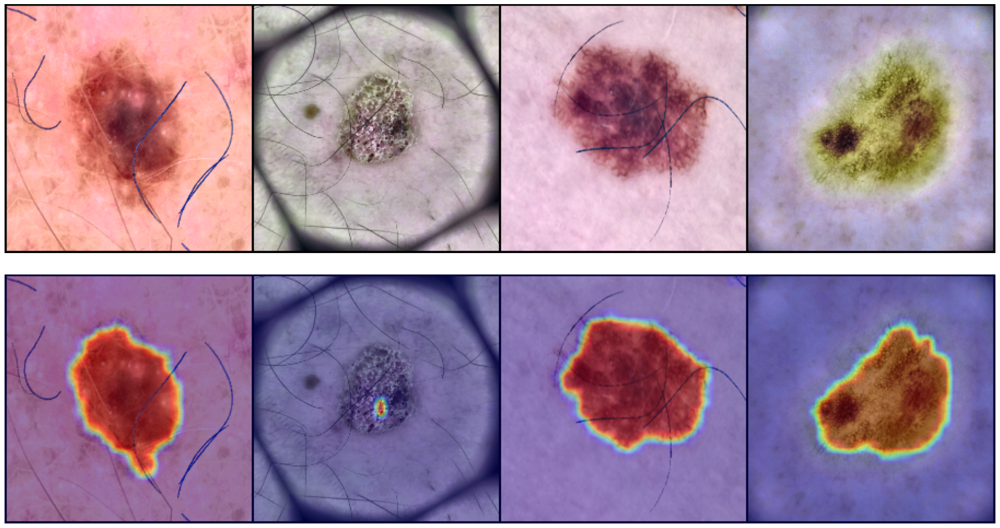

In [66]:
figure = plt.figure(figsize=(22, 12))

for idx, batch in enumerate(data_loader):
    if idx == 1:
        break
    
    # get the batch
    images, masks, labels = batch

    # add a dimension, from (32, 224, 224) to (32, 1, 224, 224) to match the attention map
    masks = masks.unsqueeze(1) 
    masks = F.adaptive_avg_pool2d(masks, 224//8)

    print(images.shape)
    print(masks.shape)

    I_images = utils.make_grid(images[:4, :, :, :], nrow=4, normalize=True, scale_each=True)
    I_atten = visualize_attn(I_images, masks[:4, :, :, :], up_factor=upscale_factor, nrow=4)

    attn1_image = transforms.ToPILImage()(I_atten)

    # Subplot 1 - Original Image
    plt.subplot(2, 1, 1)
    plt.imshow(I_images.permute((1,2,0)).cpu().numpy())
    plt.axis('off')  # Remove axis ticks and labels

    # Subplot 2 - Attention Image
    plt.subplot(2, 1, 2)
    plt.imshow(attn1_image)
    plt.axis('off')  # Remove axis ticks and labels

    plt.tight_layout()  # Adjust subplot parameters for better layout
    plt.show()

In [14]:
figure = plt.figure(figsize=(22, 12))

filenames = []

for idx, batch in enumerate(data_loader):

    # get the batch
    images, masks, labels = batch
    
    # get the images filenames
    images_filenames = dataset.images_path[idx*batch_size:idx*batch_size+batch_size]

    # get the filenames of the images from the paths
    images_filenames = [os.path.basename(file_path)  for file_path in images_filenames]

    # concatinate the images filenames with filenames list
    filenames += images_filenames

    print(idx)
    if idx == 5:
        break

print(filenames)
print(len(filenames))

0
1
2
3
4
5
['nev00001.jpg', 'nev00002.jpg', 'nev00003.jpg', 'nev00004.jpg', 'nev00005.jpg', 'nev00006.jpg', 'nev00007.jpg', 'nev00008.jpg', 'nev00009.jpg', 'nev00010.jpg', 'nev00011.jpg', 'nev00012.jpg', 'nev00013.jpg', 'nev00014.jpg', 'nev00015.jpg', 'nev00016.jpg', 'nev00017.jpg', 'nev00018.jpg', 'nev00019.jpg', 'nev00020.jpg', 'nev00021.jpg', 'nev00022.jpg', 'nev00023.jpg', 'nev00024.jpg', 'nev00025.jpg', 'nev00026.jpg', 'nev00027.jpg', 'nev00028.jpg', 'nev00029.jpg', 'nev00030.jpg', 'nev00031.jpg', 'nev00032.jpg', 'nev00033.jpg', 'nev00034.jpg', 'nev00035.jpg', 'nev00036.jpg', 'nev00037.jpg', 'nev00038.jpg', 'nev00039.jpg', 'nev00040.jpg', 'nev00041.jpg', 'nev00042.jpg', 'nev00043.jpg', 'nev00044.jpg', 'nev00045.jpg', 'nev00046.jpg', 'nev00047.jpg', 'nev00048.jpg', 'nev00049.jpg', 'nev00050.jpg', 'nev00051.jpg', 'nev00052.jpg', 'nev00053.jpg', 'nev00054.jpg', 'nev00055.jpg', 'nev00056.jpg', 'nev00057.jpg', 'nev00058.jpg', 'nev00059.jpg', 'nev00060.jpg', 'nev00061.jpg', 'nev00062.j

<Figure size 2200x1200 with 0 Axes>

### 2. Experimenting with model attention layers

Model fold=3, Challenge=2

In [2]:
model_path = 'outputs/ClassifierSegExperimentCV_224_epo50_bs32_lr1e-05_s42/2023-12-29_0940_VGG16_BN_Attention/fold_3/ClassifierSegExperimentCV_224_VGG16_BN_Attention_epo50_bs32_lr1e-05_seed42_fold3.pth'
dataset_path_val = '../datasets/challenge2/val'
ch2_labels = {'mel': 0, 'bcc': 1, 'scc': 2}

In [3]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [4]:
model = VGG16_BN_Attention(num_classes=len(ch2_labels)).to(device)

Using VGG16_BN_Attention with configurations: num_classes='3', normalize_attn='False'


In [5]:
checkpoint = torch.load(model_path)
model.load_state_dict(checkpoint['model_state_dict'])
model.eval()


VGG16_BN_Attention(
  (conv_block1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
  )
  (conv_block2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
  )
  (conv_block3): Sequential(
    (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(256, eps=1e-05,

In [6]:
_, val_images, _, val_labels, n_classes = LoadData(
        dataset_path= dataset_path_val, 
        class_labels = ch2_labels)

Loading the data from ../datasets/challenge2/val


In [7]:
val_dataset = Dataset(
        images_path=val_images, labels=val_labels, transform=True, split="val",
        input_size=(224,224))


In [8]:
val_dataloader = torch.utils.data.DataLoader(
        val_dataset, batch_size=32, shuffle=False, num_workers=4)

In [9]:
upscale_factor = 8

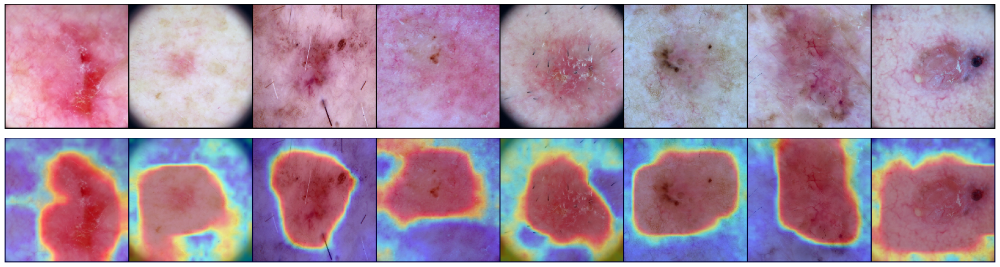

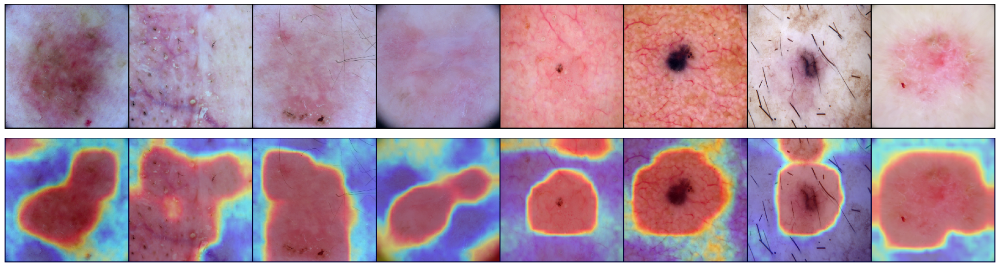

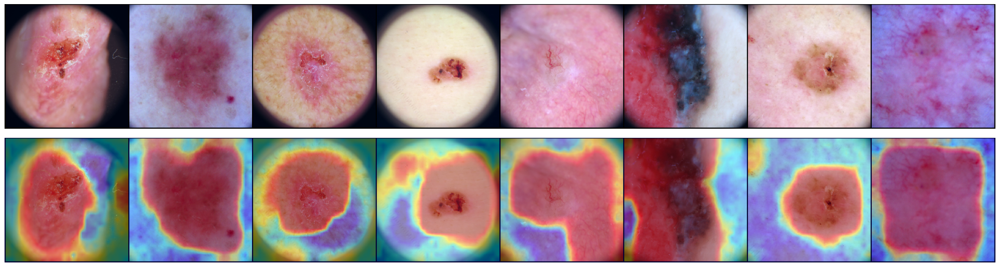

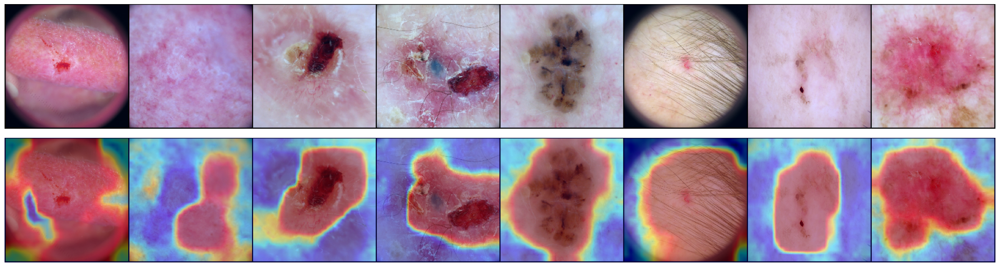

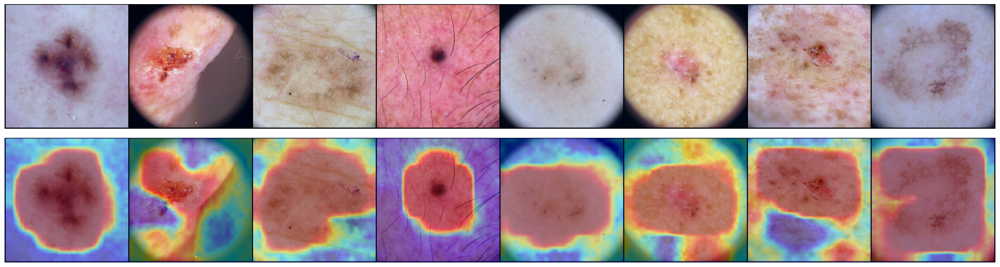

...

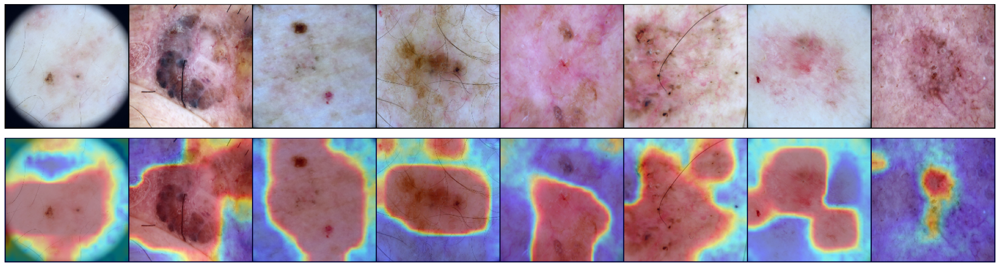

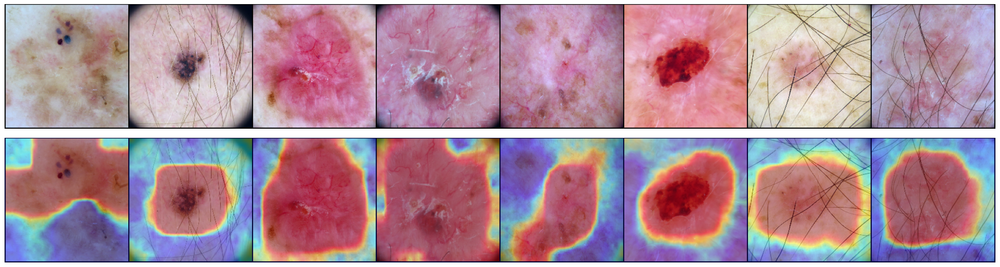

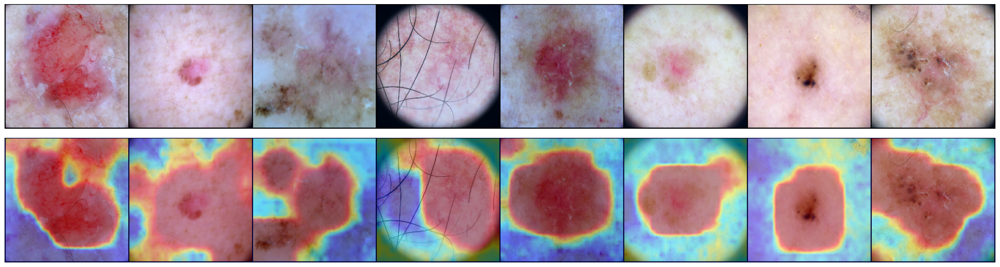

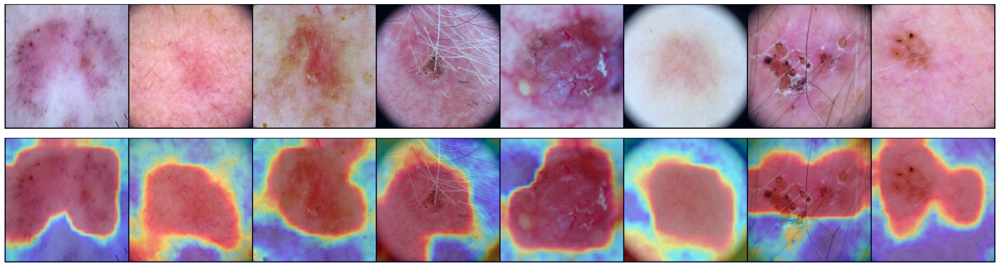

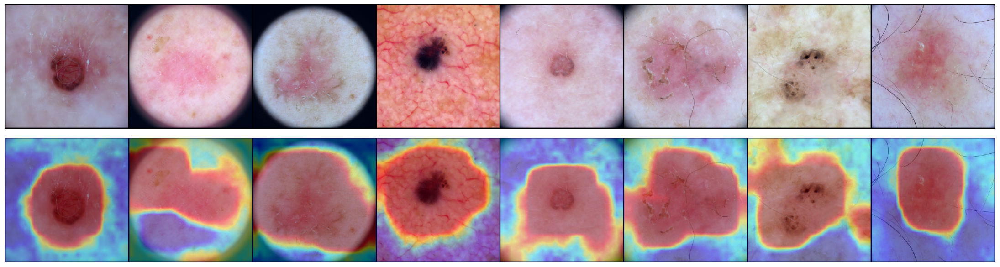

In [13]:
# Disable gradient calculation
with torch.no_grad():
    # Iterate over the validation data
    for batch_idx, (data, target) in enumerate(val_dataloader):
        data, target = data.to(device), target.to(device)

        # Forward pass
        output, att1, att2 = model(data)

        I_val = utils.make_grid(data[0:8, :, :, :], nrow=8, normalize=True, scale_each=True)
        attn1 = visualize_attn(I_val, att1[0:8, :, :, :], up_factor=upscale_factor, nrow=8)

        I_val_image = transforms.ToPILImage()(I_val)
        attn1_image = transforms.ToPILImage()(attn1)

        figure = plt.figure(figsize=(22, 6))

        # Subplot 1 - Original Image
        plt.subplot(2, 1, 1)
        plt.imshow(I_val_image)
        plt.axis('off')  # Remove axis ticks and labels

        # Subplot 2 - Attention Image
        plt.subplot(2, 1, 2)
        plt.imshow(attn1_image)
        plt.axis('off')  # Remove axis ticks and labels

        plt.tight_layout()  # Adjust subplot parameters for better layout
        plt.show()

        if batch_idx == 10:
            break
